In [ ]:
!pip install tensorflow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dir = "/content/drive/MyDrive/Colab Notebooks"

In [ ]:
dir = "/content/drive/MyDrive/Fish"

In [ ]:
import tensorflow as tf
from tensorflow.keras import models,layers
import matplotlib.pyplot as plt

In [ ]:
BATCH_SIZE=8
IMAGE_SIZE=256
CHANNELS=3
EPOCHS=80


In [ ]:
path = '/content/drive/MyDrive/Fish'

In [ ]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "/content/drive/MyDrive/Fish",
    shuffle=True,
    image_size=(IMAGE_SIZE,IMAGE_SIZE),
    batch_size=BATCH_SIZE
)

Found 185 files belonging to 3 classes.


In [ ]:
class_names = dataset.class_names
class_names

['Fish disease (EUS)', 'Fish diseases (Tail And Fin Rot)', 'Healthy Fish']

In [ ]:
len(dataset)

24

In [ ]:
for image_batch, label_batch in dataset.take(1):
    print(image_batch.shape)
    print(label_batch.numpy())

(8, 256, 256, 3)
[2 0 2 0 2 0 2 0]


In [ ]:
for image_batch, label_batch in dataset.take(1):
    print(image_batch[0])

tf.Tensor(
[[[247.      251.05469 249.89062]
  [247.      252.      248.     ]
  [247.      252.      247.45312]
  ...
  [239.17188 240.17188 235.17188]
  [251.35938 252.35938 247.35938]
  [254.89062 254.94531 250.89062]]

 [[244.10938 248.16406 247.     ]
  [243.91968 248.91968 244.91968]
  [242.95312 247.95312 243.72241]
  ...
  [218.49939 219.49939 214.49939]
  [245.70007 246.70007 241.70007]
  [254.66931 254.724   250.66931]]

 [[240.18628 244.81848 242.8125 ]
  [239.443   244.73987 240.73987]
  [238.51562 243.8125  239.97485]
  ...
  [183.69275 184.69275 179.69275]
  [228.43823 229.43823 224.43823]
  [249.96191 250.29724 245.96191]]

 ...

 [[215.67969 215.67969 215.67969]
  [214.61902 214.61902 214.61902]
  [214.41577 214.41577 214.41577]
  ...
  [169.38232 169.38232 169.38232]
  [222.88306 222.88306 222.88306]
  [249.73718 249.73718 249.73718]]

 [[223.56287 223.56287 223.56287]
  [222.19312 222.19312 222.19312]
  [222.37866 222.37866 222.37866]
  ...
  [211.53186 211.53186 211.

In [ ]:
for image_batch, label_batch in dataset.take(1):
    print(image_batch[0].numpy())

[[[227.16406 237.04358 239.40503]
  [228.69373 236.03333 243.86353]
  [228.22046 235.87671 242.20483]
  ...
  [233.      238.      241.     ]
  [233.      238.      241.     ]
  [233.      238.      241.     ]]

 [[228.85364 237.00415 242.09167]
  [229.00317 236.00317 243.80322]
  [229.99744 236.66931 242.83594]
  ...
  [233.      238.      241.     ]
  [233.      238.      241.     ]
  [233.      238.      241.     ]]

 [[229.95227 236.95227 242.95227]
  [231.09119 236.13013 244.37756]
  [231.22302 236.87927 242.87927]
  ...
  [233.      238.      241.     ]
  [233.      238.      241.     ]
  [233.      238.      241.     ]]

 ...

 [[230.13196 243.13196 236.13196]
  [231.      244.      237.     ]
  [232.16406 243.82031 238.83594]
  ...
  [227.      231.      230.     ]
  [227.      231.      230.     ]
  [227.      231.      230.     ]]

 [[230.22656 243.22656 236.22656]
  [231.      244.      237.     ]
  [231.34375 243.      238.01562]
  ...
  [227.      231.      230.     ]
  [2

In [ ]:
for image_batch, label_batch in dataset.take(1):
    print(image_batch[0].shape)

(256, 256, 3)


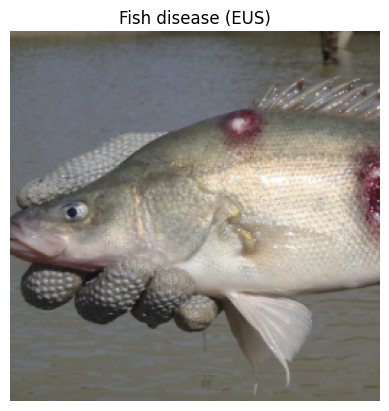

In [ ]:
for image_batch, label_batch in dataset.take(1):
    plt.imshow(image_batch[0].numpy().astype("uint8"))
    plt.title(class_names[label_batch[0]])
    plt.axis("off")

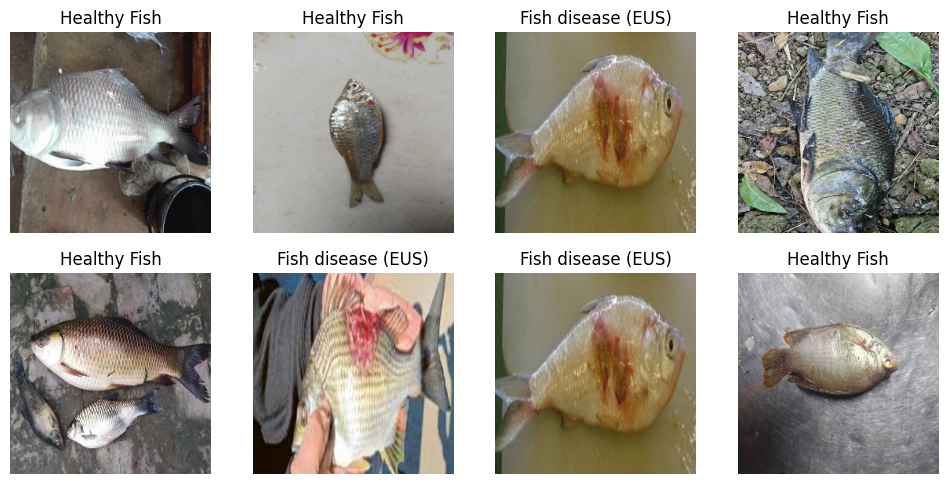

In [ ]:
plt.figure(figsize=(12,12))
for image_batch, label_batch in dataset.take(1):
    for i in range(8):
        ax = plt.subplot(4,4,i+1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        plt.title(class_names[label_batch[i]])
        plt.axis("off")

In [ ]:
len(dataset)

24

In [ ]:
#90% ==> training
#10% ==> 5% validation, 5% test

In [ ]:
train_size = 0.90
len(dataset)*train_size #90% of 24

21.6

In [ ]:
train_ds = dataset.take(22) #take first 27 batches
len(train_ds)

22

In [ ]:
remaining_ds = dataset.skip(22) #skip first 27 batches for training purpose
len(remaining_ds)

2

In [ ]:
val_size=0.05
len(dataset)*val_size

1.2000000000000002

In [ ]:
val_ds = dataset.take(1)
len(val_ds) #2 batches for validation

1

In [ ]:
test_size=0.05
len(dataset)*test_size

1.2000000000000002

In [ ]:
test_ds = dataset.take(1) #skip 2 batches out of remaining 4 for validation purpose
len(test_ds) # actual test dataset is 2 batches out of 20 batches(10 images in each batch)

1

In [ ]:
def get_dataset_partitions_tf(ds,train_split=0.90,val_split=0.05,test_split=0.05,shuffle=True,shuffle_size=10000):
    ds_size = len(ds)

    if shuffle:
        ds = ds.shuffle(shuffle_size, seed=5)

    train_size = int(train_split * ds_size)
    val_size = int(val_split * ds_size)

    train_ds = ds.take(train_size)

    val_ds = ds.skip(train_size).take(val_size)
    test_ds = ds.skip(train_size).skip(val_size)

    return train_ds,val_ds,test_ds

In [ ]:
train_ds,val_ds,test_ds = get_dataset_partitions_tf(dataset)

In [ ]:
len(train_ds)

21

In [ ]:
len(val_ds)

1

In [ ]:
len(test_ds)

2

In [ ]:
#dataset is optimized for training purposes
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds = val_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds = test_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)

In [ ]:
#created layers for preprocessing
resize_and_rescale = tf.keras.Sequential([
    layers.experimental.preprocessing.Resizing(IMAGE_SIZE,IMAGE_SIZE),
    layers.experimental.preprocessing.Rescaling(1.0/255)

])

In [ ]:
#data augmention to build our actual model
data_augmentation = tf.keras.Sequential([
    layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
    layers.experimental.preprocessing.RandomRotation(0.2)

])

In [ ]:
#mode building
input_shape = (BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, CHANNELS)
n_classes=3

model = models.Sequential([
    resize_and_rescale,
    data_augmentation,
    layers.Conv2D(32, (3,3), activation='relu', input_shape = input_shape),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64, kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64,(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64,(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Conv2D(64,(3,3), activation='relu'),
    layers.MaxPooling2D((2,2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(n_classes, activation='softmax')  #normalize the probabily of the last layer classes
])

model.build(input_shape=input_shape)

In [ ]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (8, 256, 256, 3)          0         
                                                                 
 sequential_1 (Sequential)   (8, 256, 256, 3)          0         
                                                                 
 conv2d (Conv2D)             (8, 254, 254, 32)         896       
                                                                 
 max_pooling2d (MaxPooling2  (8, 127, 127, 32)         0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (8, 125, 125, 64)         18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (8, 62, 62, 64)           0         
 g2D)                                                 

In [ ]:
model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']

)

In [ ]:
history = model.fit(
    train_ds,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    verbose=1,
    validation_data=val_ds
)

Epoch 1/80
21/21 [==============================] - 12s 576ms/step - loss: 0.4157 - accuracy: 0.7888 - val_loss: 0.1935 - val_accuracy: 1.0000
Epoch 2/80
21/21 [==============================] - 12s 575ms/step - loss: 0.4316 - accuracy: 0.8075 - val_loss: 0.2165 - val_accuracy: 0.8750
Epoch 3/80
21/21 [==============================] - 12s 564ms/step - loss: 0.4314 - accuracy: 0.8075 - val_loss: 0.2725 - val_accuracy: 0.8750
Epoch 4/80
21/21 [==============================] - 14s 656ms/step - loss: 0.5357 - accuracy: 0.8137 - val_loss: 0.3015 - val_accuracy: 0.8750
Epoch 5/80
21/21 [==============================] - 12s 575ms/step - loss: 0.4877 - accuracy: 0.7702 - val_loss: 0.2803 - val_accuracy: 1.0000
Epoch 6/80
21/21 [==============================] - 12s 598ms/step - loss: 0.5097 - accuracy: 0.7702 - val_loss: 0.3129 - val_accuracy: 0.8750
Epoch 7/80
21/21 [==============================] - 11s 540ms/step - loss: 0.4536 - accuracy: 0.8137 - val_loss: 0.2324 - val_accuracy: 1.0000

In [ ]:
scores = model.evaluate(test_ds)

2/2 [==============================] - 0s 239ms/step - loss: 0.5139 - accuracy: 0.9375


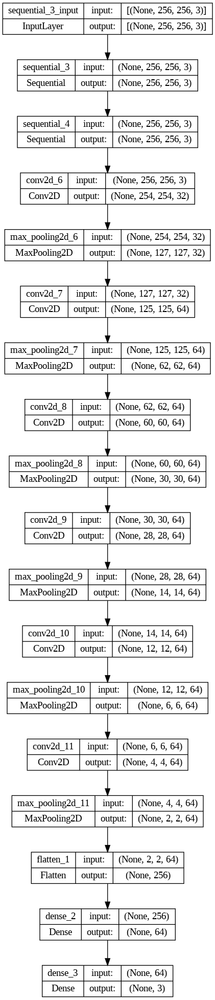

In [ ]:
from tensorflow.keras.utils import plot_model



# Visualize the model
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)


In [ ]:
scores

[0.5139189958572388, 0.9375]

In [ ]:
history

In [ ]:
history.params

{'verbose': 1, 'epochs': 80, 'steps': 21}

In [ ]:
history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

In [ ]:
len(history.history['accuracy'])

80

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

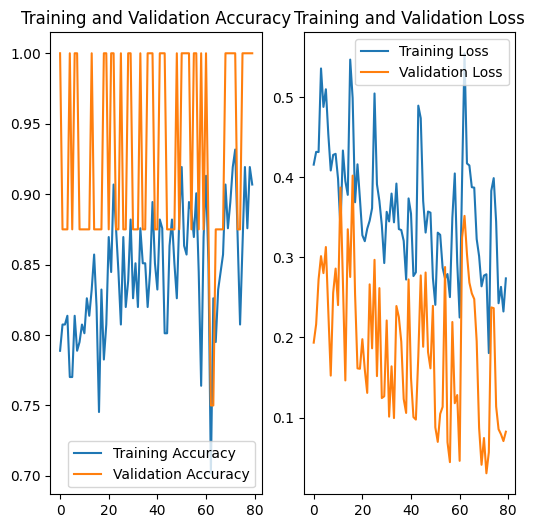

In [ ]:
plt.figure(figsize=(6,6))
plt.subplot(1,2,1)
plt.plot(range(EPOCHS), acc, label='Training Accuracy')
plt.plot(range(EPOCHS), val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')


plt.subplot(1,2,2)
plt.plot(range(EPOCHS), loss, label='Training Loss')
plt.plot(range(EPOCHS), val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
for images_batch, labels_batch in test_ds.take(1):

    print(images_batch[0].numpy())

[[[ 36.17688   41.17688   37.17688 ]
  [ 45.93567   47.93567   44.93567 ]
  [ 46.784424  51.784424  47.784424]
  ...
  [216.02185  212.56873  209.27502 ]
  [167.9862   165.31433  155.32996 ]
  [138.17249  137.17249  117.06311 ]]

 [[ 30.78125   35.78125   31.078125]
  [ 36.613525  39.322144  35.382812]
  [ 31.851562  35.796875  31.445312]
  ...
  [223.26697  219.81384  215.7201  ]
  [168.93616  166.50049  155.69214 ]
  [136.64844  135.64844  115.53906 ]]

 [[ 47.873413  52.873413  46.873413]
  [ 46.601562  50.617188  44.945312]
  [ 47.60901   49.60901   44.60901 ]
  ...
  [219.02344  215.57031  211.47656 ]
  [168.96265  166.96265  154.63452 ]
  [139.38745  138.38745  118.278076]]

 ...

 [[ 36.328125  33.328125  28.328125]
  [ 36.914062  33.914062  28.914062]
  [ 36.945435  33.945435  28.945435]
  ...
  [ 30.305054  35.382935  37.21118 ]
  [ 38.867188  43.867188  46.867188]
  [ 48.262573  53.262573  56.262573]]

 [[ 37.445923  34.445923  29.445923]
  [ 33.521606  30.521606  25.521606]


First image to predict
Actual label: Healthy Fish
1/1 [==============================] - 0s 154ms/step
Predicted label: Healthy Fish


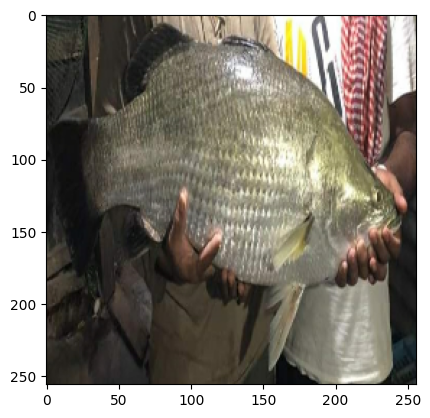

In [ ]:
import numpy as np
for images_batch, labels_batch in test_ds.take(1):

    first_image = images_batch[0].numpy().astype('uint8')
    first_label = labels_batch[0].numpy()

    print("First image to predict")
    plt.imshow(first_image)
    print("Actual label:",class_names[first_label])

    batch_prediction = model.predict(images_batch)
    print("Predicted label:",class_names[np.argmax(batch_prediction[0])])

In [ ]:
def predict(model, img):
    img_array = tf.keras.preprocessing.image.img_to_array(images[i].numpy())
    img_array = tf.expand_dims(img_array,0)

    predictions = model.predict(img_array)

    predicted_class = class_names[np.argmax(predictions[0])]
    confidence = round(100*(np.max(predictions[0])),2)
    return predicted_class, confidence

1/1 [==============================] - 0s 30ms/step


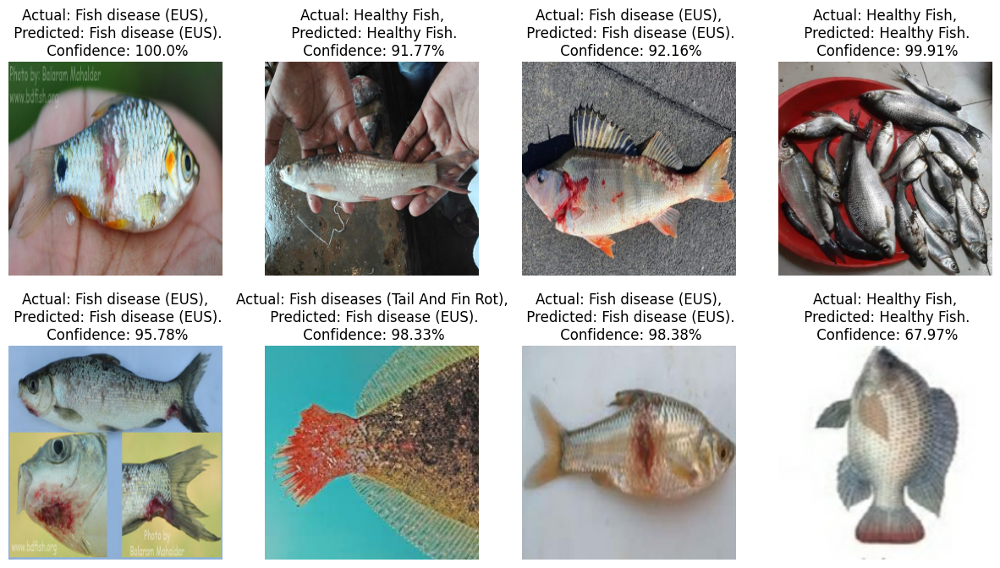

In [ ]:
plt.figure(figsize=(15,8))
for images, labels in test_ds.take(1):
    for i in range(8):
        ax = plt.subplot(2,4, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))

        predicted_class, confidence = predict(model, images[i].numpy())
        actual_class = class_names[labels[i]]

        plt.title(f"Actual: {actual_class},\n Predicted: {predicted_class}.\n Confidence: {confidence}%")

        plt.axis("off")

2/2 [==============================] - 0s 146ms/step


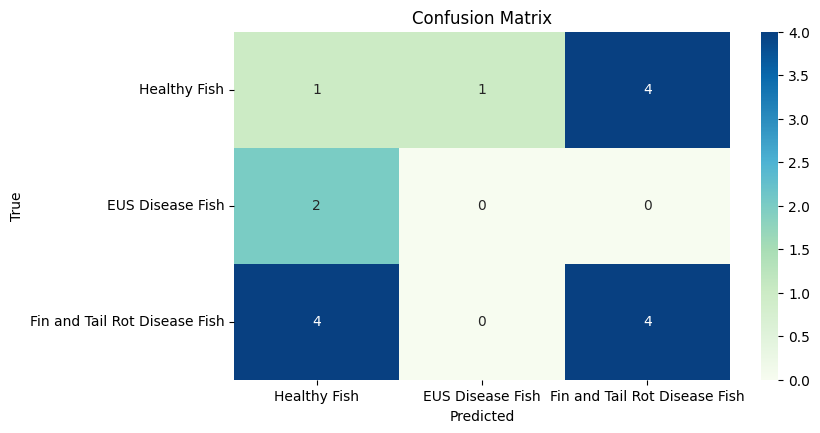

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Assuming you have a model 'model' and a test dataset 'test_ds'
# Generate predictions from the model using the test dataset
y_pred_probs = model.predict(test_ds)
y_pred_labels = np.argmax(y_pred_probs, axis=1)

# Get the true labels from the test dataset
y_true = np.concatenate([y for _, y in test_ds], axis=0)  # Assuming test_ds is a tf.data.Dataset

# Define class names manually (replace with your actual class names)
class_names = ["Healthy Fish", "EUS Disease Fish", "Fin and Tail Rot Disease Fish"]

# Calculate the confusion matrix
cm = confusion_matrix(y_true, y_pred_labels)

# Create a heatmap for the confusion matrix with a different color map
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')

# Adjust the layout to provide more space for bottom labels
plt.subplots_adjust(bottom=0.30)

plt.show()


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report

# Assuming you have a model 'model' and a test dataset 'test_ds'
# Generate predictions from the model using the test dataset
y_true = np.concatenate([y for _, y in test_ds], axis=0)  # Assuming test_ds is a tf.data.Dataset
y_pred_probs = model.predict(test_ds)
y_pred_labels = y_pred_probs.argmax(axis=1)

# Calculate accuracy, precision, recall, and F1 score
accuracy = accuracy_score(y_true, y_pred_labels)
precision = precision_score(y_true, y_pred_labels, average='macro')  # 'macro' for multiclass classification
recall = recall_score(y_true, y_pred_labels, average='macro')
f1 = f1_score(y_true, y_pred_labels, average='macro')

# Generate a classification report
report = classification_report(y_true, y_pred_labels, target_names=class_names)

# Print the results
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print("\nClassification Report:\n", report)


2/2 [==============================] - 0s 209ms/step
Accuracy: 0.9375
Precision: 0.9524
Recall: 0.8333
F1 Score: 0.8632

Classification Report:
                                precision    recall  f1-score   support

                 Healthy Fish       0.86      1.00      0.92         6
             EUS Disease Fish       1.00      0.50      0.67         2
Fin and Tail Rot Disease Fish       1.00      1.00      1.00         8

                     accuracy                           0.94        16
                    macro avg       0.95      0.83      0.86        16
                 weighted avg       0.95      0.94      0.93        16



In [ ]:
import tensorflow as tf
import os
import numpy as np
import random
from tqdm import tqdm
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Activation, MaxPooling2D
from keras.models import Model
from keras.applications import MobileNetV2,ResNet50,ResNet50V2,InceptionV3,InceptionResNetV2,Xception,VGG16,NASNetMobile,EfficientNetV2L
from keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import keras.utils as image
import seaborn as sns
from tensorflow.keras.models import Sequential
from sklearn.preprocessing import MultiLabelBinarizer
import matplotlib.image as mpimg
from PIL import Image
import shutil
sns.set()
%matplotlib inline

In [ ]:
dir = "/content/drive/MyDrive/New folder fish/training"

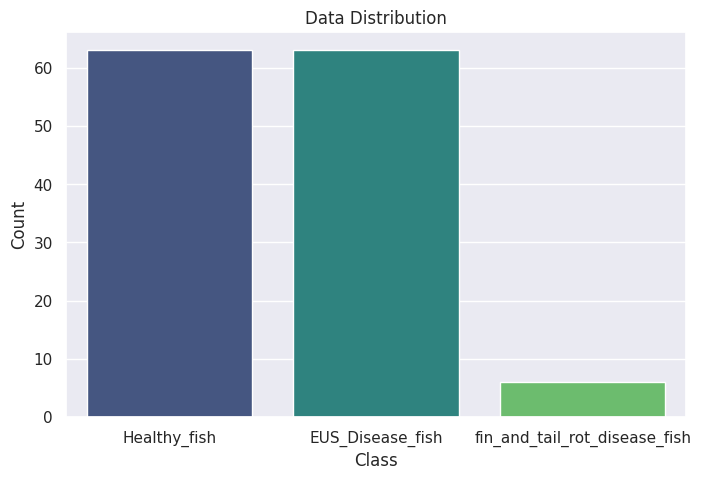

In [ ]:
class_labels = os.listdir(dir)
image_counts = [len(os.listdir(os.path.join(dir, label))) for label in class_labels]
plt.figure(figsize=(8,5))
sns.barplot(x=class_labels, y=image_counts, palette="viridis")
plt.title('Data Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.show()


In [ ]:
train_datagen=ImageDataGenerator(
    rescale=1./255,# 0 - 1
    zoom_range=0.2,
    shear_range = 0.1,
    horizontal_flip=True,
    rotation_range=(10),
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=(0.5,1.8),

)

In [ ]:

train_generator=train_datagen.flow_from_directory(
    '/content/drive/MyDrive/New folder fish/training',
    target_size=(224,224),
    batch_size=32,
    class_mode='categorical',
    color_mode='rgb',
    shuffle=True
)
train_generator.class_indices

Found 132 images belonging to 3 classes.


{'EUS_Disease_fish': 0, 'Healthy_fish': 1, 'fin_and_tail_rot_disease_fish': 2}

In [ ]:
print(train_generator.labels)


In [ ]:

test_datagen=ImageDataGenerator(
    rescale=1./255,
    zoom_range=0.2,
    shear_range = 0.1,
    horizontal_flip=True,
    rotation_range=(10),
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=(0.5,1.8),

)

In [ ]:

test_generator=train_datagen.flow_from_directory(
    '/content/drive/MyDrive/New folder fish/testing',
    target_size=(224,224),
    batch_size=32,
    class_mode='categorical',
    color_mode='rgb',
    shuffle=True,

)
test_generator.class_indices

Found 39 images belonging to 3 classes.


{'EUS_Disease_fish': 0, 'Healthy_fish': 1, 'fin_and_tail_rot_disease_fish': 2}

In [ ]:
test_generator.labels

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2], dtype=int32)

In [ ]:
validation_datagen=ImageDataGenerator(rescale= 1./255)
validation_generator=validation_datagen.flow_from_directory(
    '/content/drive/MyDrive/New folder fish/testing',
    target_size=(224,224),
    batch_size=32,
    class_mode='categorical',
    color_mode='rgb',
)
validation_generator.class_indices


Found 39 images belonging to 3 classes.


{'EUS_Disease_fish': 0, 'Healthy_fish': 1, 'fin_and_tail_rot_disease_fish': 2}

In [ ]:
validation_generator.labels


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2], dtype=int32)

In [ ]:
import os
import cv2

# Set the path to your main folder with subfolders
main_folder = '/content/drive/MyDrive/New folder fish/training'

# Function to get the number of channels for an image
def get_num_channels(image_path):
    image = cv2.imread(image_path)
    return image.shape[2]

total_channels = 0
total_images = 0

# Iterate through subfolders and images
for root, dirs, files in os.walk(main_folder):
    for file in files:
        if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif')):
            image_path = os.path.join(root, file)
            num_channels = get_num_channels(image_path)
            total_channels += num_channels
            total_images += 1

if total_images > 0:
    average_channels = total_channels / total_images
    print(f"Average number of channels for all images: {average_channels:.2f}")
else:
    print("No images found in the specified folders.")


Average number of channels for all images: 3.00


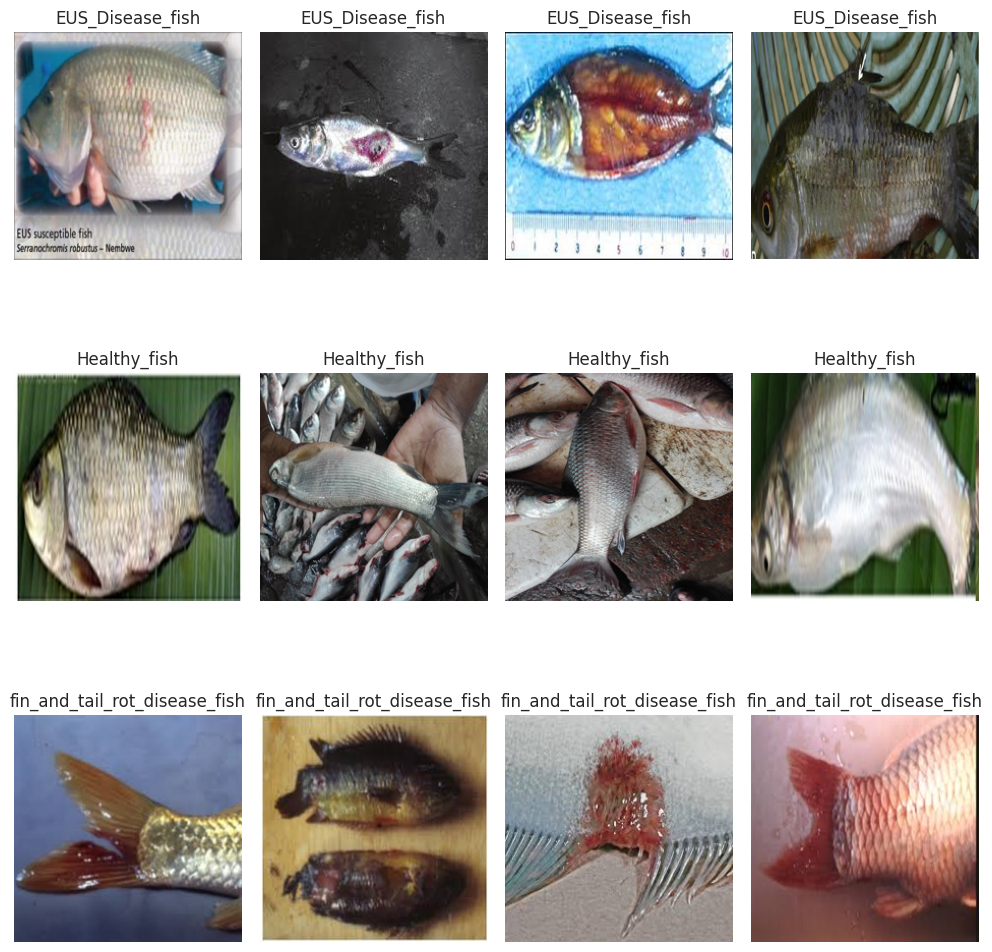

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image

dir1 = '/content/drive/MyDrive/New folder fish/training'  # Replace with the actual directory path
Disease_image_path = os.path.join(dir1, "EUS_Disease_fish")
Healthy_image_path = os.path.join(dir1, "Healthy_fish")
fin_and_tail_rot_disease_fish_image_path = os.path.join(dir1, "fin_and_tail_rot_disease_fish")

fig, axes = plt.subplots(3, 4, figsize=(10, 11))
class_labels = ["EUS_Disease_fish", "Healthy_fish", "fin_and_tail_rot_disease_fish"]

for i, folder in enumerate([Disease_image_path, Healthy_image_path, fin_and_tail_rot_disease_fish_image_path]):
    images = os.listdir(folder)[:4]  # Display the first 4 images from each class
    for j, image_name in enumerate(images):
        img_path = os.path.join(folder, image_name)
        img = Image.open(img_path)
        img = img.resize((224, 224))
        axes[i, j].imshow(img)
        axes[i, j].axis('off')
        axes[i, j].set_title(class_labels[i])

plt.tight_layout()
plt.show()


In [ ]:
import os
import cv2

# Define a function to enhance image contrast without converting to grayscale
def enhance_contrast(image_path):
    image = cv2.imread(image_path)

    # Check if the image was loaded successfully
    if image is None:
        print(f"Failed to load image: {image_path}")
        return None
        # Print the shape of the loaded image (for debugging)
    print(f"Loaded image shape: {image.shape}")

    # Enhance contrast for each color channel (BGR)
    enhanced_channels = [cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8)).apply(channel) for channel in cv2.split(image)]
    enhanced_image = cv2.merge(enhanced_channels)

    return enhanced_image

# Specify the folders with your color images
image_folders = ["/content/drive/MyDrive/New folder fish/training/Healthy_fish",
                 "/content/drive/MyDrive/New folder fish/training/EUS_Disease_fish",
                 "/content/drive/MyDrive/New folder fish/training/fin_and_tail_rot_disease_fish"]

# Directory where you want to save the enhanced images (parent directory)
output_directory = "/content/drive/MyDrive/New folder fish/enhanced_images"

# Create the output directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

# Initialize a list to store the names of successfully processed images
processed_images = []

# Loop through each folder and enhance the contrast of the images
for folder in image_folders:
    folder_path = os.path.join(folder)
    folder_name = os.path.basename(folder)  # Extract the folder name
    output_folder = os.path.join(output_directory, folder_name)
    os.makedirs(output_folder, exist_ok=True)

    # Process and save each image in the folder
    for filename in os.listdir(folder_path):
        if filename.endswith(".jpg") or filename.endswith(".png"):  # Adjust file extensions as needed
            image_path = os.path.join(folder_path, filename)
            enhanced_image = enhance_contrast(image_path)

            # Check if image loading failed
            if enhanced_image is not None:
                # Construct the output path in the new directory
                output_path = os.path.join(output_folder, filename)

                # Save the enhanced image to the new directory
                cv2.imwrite(output_path, enhanced_image)

                # Add the name of the successfully processed image to the list
                processed_images.append(filename)

print("Color contrast-enhanced images saved to the", output_directory, "directory.")
print(f"Successfully processed images:", processed_images)


Loaded image shape: (103, 235, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (75, 272, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (87, 240, 3)
Loaded image shape: (113, 220, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (68, 216, 3)
Loaded image shape: (102, 201, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (111, 150, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (66, 250, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (360, 480, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (53, 250, 3)
Loaded image shape: (69, 272, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: (128, 149, 3)
Loaded image shape: (122, 251, 3)
Loaded image shape: (480, 360, 3)
Loaded image shape: 

Loaded image shape: (480, 360, 3)
Loaded image shape: (864, 436, 3)
Loaded image shape: (960, 720, 3)
Loaded image shape: (103, 235, 3)
Loaded image shape: (4160, 3120, 3)


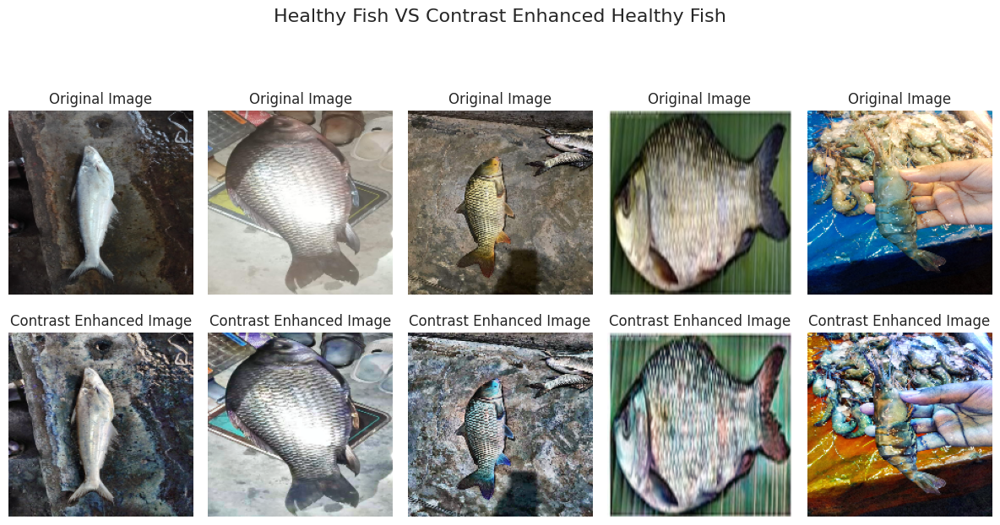

Contrast-enhanced healthy fish images visualized.


In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# Specify the folder with your "healthy fish" images
healthy_fish_folder = "/content/drive/MyDrive/New folder fish/training/Healthy_fish"

# Directory where the enhanced images are saved
output_directory = "/content/drive/MyDrive/New folder fish/enhanced_images/Healthy_fish"

# Create the output directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

# Number of healthy fish images to visualize
images_to_visualize = 5

# Set the desired width and height for resizing
desired_width = 180  # You can adjust this to your preferred size
desired_height = 180

# Get a list of image filenames and shuffle them
image_filenames = os.listdir(healthy_fish_folder)
random.shuffle(image_filenames)

# Initialize a counter to limit the number of images to visualize
count = 0

# Create subplots to display images
plt.figure(figsize=(12, 7))
plt.suptitle("Healthy Fish VS Contrast Enhanced Healthy Fish", fontsize=16)

for filename in image_filenames:
    if count < images_to_visualize and (filename.endswith(".jpg") or filename.endswith(".png")):
        image_path = os.path.join(healthy_fish_folder, filename)
        enhanced_image = enhance_contrast(image_path)

        # Resize the original image
        original_image = cv2.imread(image_path)
        original_image = cv2.resize(original_image, (desired_width, desired_height))

        # Resize the enhanced image
        enhanced_image = cv2.resize(enhanced_image, (desired_width, desired_height))

        # Plot the original image in the left column
        plt.subplot(2, images_to_visualize, count + 1)
        plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB), cmap='gray')
        plt.title('Original Image')
        plt.axis('off')  # Hide axis labels and ticks

        # Plot the enhanced image in the right column
        plt.subplot(2, images_to_visualize, count + images_to_visualize + 1)
        plt.imshow(enhanced_image, cmap='gray')
        plt.title('Contrast Enhanced Image')
        plt.axis('off')  # Hide axis labels and ticks

        count += 1

# Adjust spacing and display the plots
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print("Contrast-enhanced healthy fish images visualized.")


Loaded image shape: (480, 360, 3)
Loaded image shape: (194, 259, 3)
Loaded image shape: (496, 484, 3)
Loaded image shape: (136, 684, 3)
Loaded image shape: (311, 512, 3)


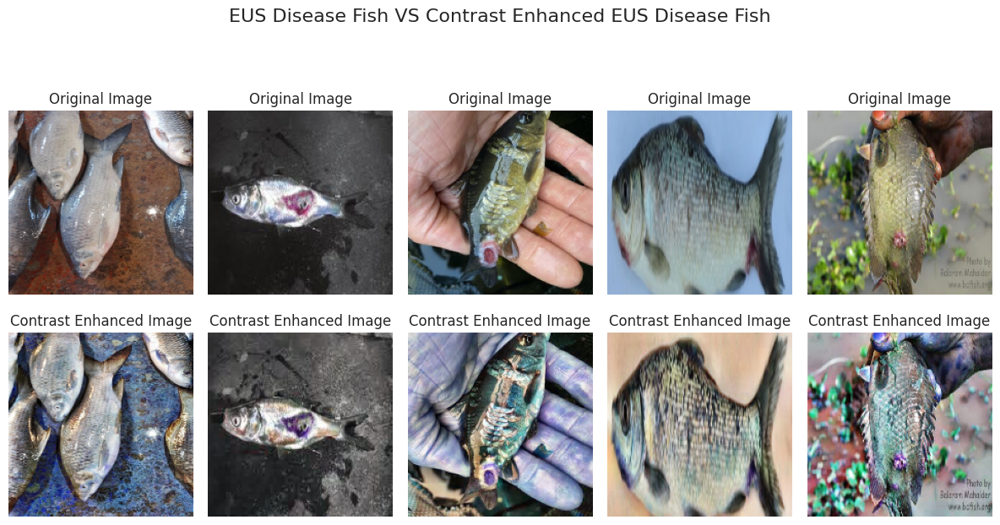

Contrast-enhanced EUS Disease Fish images visualized.


In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# Specify the folder with your "EUS Disease Fish" images
eus_disease_fish_folder = "/content/drive/MyDrive/New folder fish/training/EUS_Disease_fish"

# Directory where the enhanced images are saved
output_directory = "/content/drive/MyDrive/New folder fish/enhanced_images/EUS_Disease_fish"

# Create the output directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

# Number of EUS Disease Fish images to visualize
images_to_visualize = 5

# Set the desired width and height for resizing
desired_width = 180  # You can adjust this to your preferred size
desired_height = 180

# Get a list of image filenames and shuffle them
image_filenames = os.listdir(eus_disease_fish_folder)
random.shuffle(image_filenames)

# Initialize a counter to limit the number of images to visualize
count = 0

# Create subplots to display images
plt.figure(figsize=(12, 7))
plt.suptitle("EUS Disease Fish VS Contrast Enhanced EUS Disease Fish", fontsize=16)

for filename in image_filenames:
    if count < images_to_visualize and (filename.endswith(".jpg") or filename.endswith(".png")):
        image_path = os.path.join(eus_disease_fish_folder, filename)
        enhanced_image = enhance_contrast(image_path)

        # Resize the original image
        original_image = cv2.imread(image_path)
        original_image = cv2.resize(original_image, (desired_width, desired_height))

        # Resize the enhanced image
        enhanced_image = cv2.resize(enhanced_image, (desired_width, desired_height))

        # Plot the original image in the left column
        plt.subplot(2, images_to_visualize, count + 1)
        plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB), cmap='gray')
        plt.title('Original Image')
        plt.axis('off')  # Hide axis labels and ticks

        # Plot the enhanced image in the right column
        plt.subplot(2, images_to_visualize, count + images_to_visualize + 1)
        plt.imshow(enhanced_image, cmap='gray')
        plt.title('Contrast Enhanced Image')
        plt.axis('off')  # Hide axis labels and ticks

        count += 1

# Adjust spacing and display the plots with the main title closer to the images
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print("Contrast-enhanced EUS Disease Fish images visualized.")


Loaded image shape: (201, 251, 3)
Loaded image shape: (215, 235, 3)
Loaded image shape: (216, 233, 3)
Loaded image shape: (160, 316, 3)
Loaded image shape: (219, 230, 3)


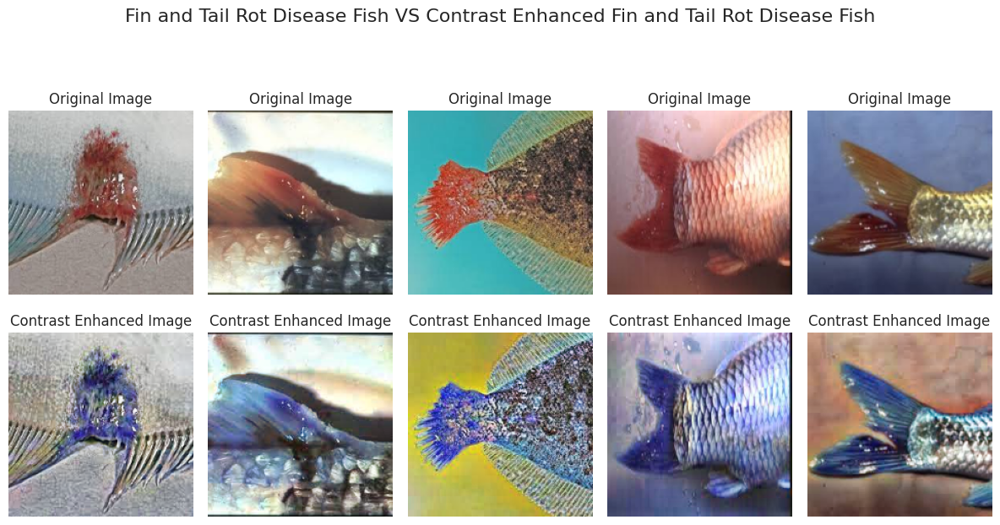

Contrast-enhanced Fin and Tail Rot Disease Fish images visualized.


In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# Specify the folder with your "Fin and Tail Rot Disease Fish" images
fin_tail_rot_folder = "/content/drive/MyDrive/New folder fish/training/fin_and_tail_rot_disease_fish"

# Directory where the enhanced images are saved
output_directory = "/content/drive/MyDrive/New folder fish/enhanced_images/fin_and_tail_rot_disease_fish"

# Create the output directory if it doesn't exist
os.makedirs(output_directory, exist_ok=True)

# Number of Fin and Tail Rot Disease Fish images to visualize
images_to_visualize = 5

# Set the desired width and height for resizing
desired_width = 180  # You can adjust this to your preferred size
desired_height = 180

# Get a list of image filenames and shuffle them
image_filenames = os.listdir(fin_tail_rot_folder)
random.shuffle(image_filenames)

# Initialize a counter to limit the number of images to visualize
count = 0

# Create subplots to display images
plt.figure(figsize=(12, 7))
plt.suptitle("Fin and Tail Rot Disease Fish VS Contrast Enhanced Fin and Tail Rot Disease Fish", fontsize=16)

for filename in image_filenames:
    if count < images_to_visualize and (filename.endswith(".jpg") or filename.endswith(".png")):
        image_path = os.path.join(fin_tail_rot_folder, filename)
        enhanced_image = enhance_contrast(image_path)

        # Resize the original image
        original_image = cv2.imread(image_path)
        original_image = cv2.resize(original_image, (desired_width, desired_height))

        # Resize the enhanced image
        enhanced_image = cv2.resize(enhanced_image, (desired_width, desired_height))

        # Plot the original image in the left column
        plt.subplot(2, images_to_visualize, count + 1)
        plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB), cmap='gray')
        plt.title('Original Image')
        plt.axis('off')  # Hide axis labels and ticks

        # Plot the enhanced image in the right column
        plt.subplot(2, images_to_visualize, count + images_to_visualize + 1)
        plt.imshow(enhanced_image, cmap='gray')
        plt.title('Contrast Enhanced Image')
        plt.axis('off')  # Hide axis labels and ticks

        count += 1

# Adjust spacing and display the plots with the main title closer to the images
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

print("Contrast-enhanced Fin and Tail Rot Disease Fish images visualized.")


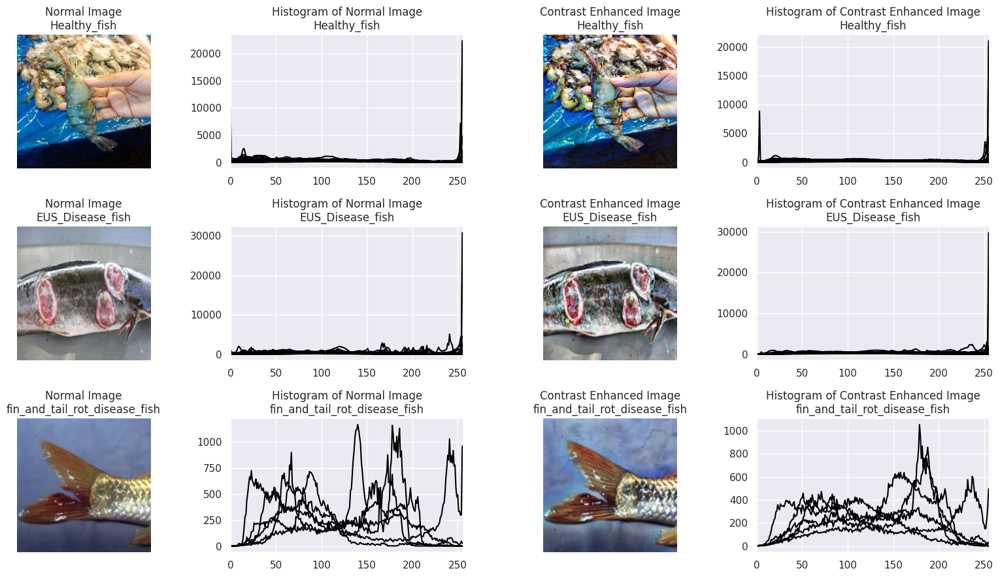

In [ ]:
import os
import cv2
import random
import matplotlib.pyplot as plt

# Define a function to enhance image contrast without converting to grayscale
def enhance_contrast(image_path):
    image = cv2.imread(image_path)

    # Check if the image was loaded successfully
    if image is None:
        print(f"Failed to load image: {image_path}")
        return None

    # Enhance contrast for each color channel (BGR)
    enhanced_channels = [cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8)).apply(channel) for channel in cv2.split(image)]
    enhanced_image = cv2.merge(enhanced_channels)

    return enhanced_image

# Specify the desired image size
desired_size = (230, 230)  # Adjust the size as needed

# Specify the parent folder with the three condition folders
parent_folder = "/content/drive/MyDrive/New folder fish/training"

# Contrast-enhanced images folder
enhanced_folder = "/content/drive/MyDrive/New folder fish/enhanced_images"

# Condition names and their respective subfolders
conditions = ["Healthy_fish", "EUS_Disease_fish", "fin_and_tail_rot_disease_fish"]

# Create a figure with adjusted subplots (wider but smaller height)
plt.figure(figsize=(16, 3 * len(conditions)))

for row, condition in enumerate(conditions, start=1):
    image_folder = os.path.join(parent_folder, condition)
    enhanced_image_folder = os.path.join(enhanced_folder, condition)

    image_files = os.listdir(image_folder)
    enhanced_image_files = os.listdir(enhanced_image_folder)

    # Shuffle the normal image files
    random.shuffle(image_files)

    for image_file in image_files:
        if image_file.endswith(".jpg"):
            image_path = os.path.join(image_folder, image_file)
            enhanced_image_path = os.path.join(enhanced_image_folder, image_file)
            image = cv2.imread(image_path)
            enhanced_image = cv2.imread(enhanced_image_path)

            if image is not None and enhanced_image is not None:
                # Resize images to the desired size
                image = cv2.resize(image, desired_size)
                enhanced_image = cv2.resize(enhanced_image, desired_size)

                # Create histograms
                hist_original = cv2.calcHist([image], [0], None, [256], [0, 256])
                hist_enhanced = cv2.calcHist([enhanced_image], [0], None, [256], [0, 256])

                # Plot the original image with labels
                plt.subplot(len(conditions), 4, row * 4 - 3)
                plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
                plt.title(f'Normal Image\n{condition}')
                plt.axis('off')

                # Plot the histogram of the original image
                plt.subplot(len(conditions), 4, row * 4 - 2)
                plt.plot(hist_original, color='black')
                plt.title(f'Histogram of Normal Image\n{condition}')
                plt.xlim([0, 256])

                # Plot the contrast-enhanced image with labels
                plt.subplot(len(conditions), 4, row * 4 - 1)
                plt.imshow(cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2RGB))
                plt.title(f'Contrast Enhanced Image\n{condition}')
                plt.axis('off')

                # Plot the histogram of the contrast-enhanced image
                plt.subplot(len(conditions), 4, row * 4)
                plt.plot(hist_enhanced, color='black')
                plt.title(f'Histogram of Contrast Enhanced Image\n{condition}')
                plt.xlim([0, 256])

plt.tight_layout()
plt.show()


In [ ]:
import os
import cv2
import random
import pandas as pd
import numpy as np
from skimage.feature import greycomatrix, greycoprops
from itertools import combinations
from scipy.stats import kurtosis, skew
import math



# Define a function to extract texture features from an image
def extract_texture_features(gray_image):
    # Compute the co-occurrence matrix
    glcm = greycomatrix(gray_image, [1], [0], symmetric=True, normed=True)

    # Compute texture properties from the co-occurrence matrix
    contrast = greycoprops(glcm, 'contrast')[0, 0]
    correlation = greycoprops(glcm, 'correlation')[0, 0]
    energy = greycoprops(glcm, 'energy')[0, 0]
    homogeneity = greycoprops(glcm, 'homogeneity')[0, 0]

    # Additional statistical features
    mean = np.mean(gray_image)
    std_deviation = np.std(gray_image)
    entropy = -sum(p * math.log2(p) for p in cv2.calcHist([gray_image], [0], None, [256], [0, 256]) if p > 0)
    rms = mean ** 0.5
    variance = std_deviation ** 2
    smoothness = 1 - (1 / (1 + variance))
    kurt = kurtosis(gray_image.flatten())
    skewness = skew(gray_image.flatten())
    idm = sum(1 / (1 + (d - d_2) ** 2) for d, d_2 in combinations(range(256), 2))

    # Return the extracted features
    return {
        'Contrast': contrast,
        'Correlation': correlation,
        'Energy': energy,
        'Homogeneity': homogeneity,
        'Mean': mean,
        'Std Deviation': std_deviation,
        'Entropy': entropy,
        'RMS': rms,
        'Variance': variance,
        'Smoothness': smoothness,
        'Kurtosis': kurt,
        'Skewness': skewness,
        'IDM': idm,
    }

# Specify the desired image size
desired_size = (200, 200)  # Adjust the size as needed

# Specify the parent folder with the three condition folders
parent_folder = "/content/drive/MyDrive/New folder fish/enhanced_images"

# Modify the paths of the contrast-enhanced image folders based on your specific folder structure
enhanced_folders = [
    "/content/drive/MyDrive/New folder fish/enhanced_images/Healthy_fish",
    "/content/drive/MyDrive/New folder fish/enhanced_images/EUS_Disease_fish",
    "/content/drive/MyDrive/New folder fish/enhanced_images/fin_and_tail_rot_disease_fish",
]

# Condition names
conditions = ["Healthy_fish", "EUS_Disease_fish", "fin_and_tail_rot_disease_fish"]

# Create a DataFrame to store the texture features
feature_df = pd.DataFrame(columns=[
    'Feature', 'Image 1', 'Image 2','Image 3','Image 4','Image 5','Image 6',
])

# Iterate over the condition folders
for i, condition in enumerate(conditions):
    enhanced_image_folder = enhanced_folders[i]

    image_files = os.listdir(enhanced_image_folder)

    # Randomly select 2 images
    selected_images = random.sample(image_files, 2)

    # Initialize an empty dictionary to store the texture features
    features_dict = {}

    for j, image_file in enumerate(selected_images):
        if image_file.endswith(".jpg"):
            enhanced_image_path = os.path.join(enhanced_image_folder, image_file)
            enhanced_image = cv2.imread(enhanced_image_path)

            if enhanced_image is not None:
                # Resize the image to the desired size
                enhanced_image = cv2.resize(enhanced_image, desired_size)

                # Convert the image to grayscale
                gray_image = cv2.cvtColor(enhanced_image, cv2.COLOR_BGR2GRAY)

                # Extract texture features for the enhanced image
                features = extract_texture_features(gray_image)

                # Store the features in the dictionary
                features_dict[f'Image {j + 1} - Enhanced {condition}'] = features

    # Create a new row in the DataFrame for each feature
    for feature_name in features_dict.get('Image 1 - Enhanced Healthy_fish', {}):
        feature_values = [features_dict.get(f'Image {j + 1} - Enhanced {condition}', {}).get(feature_name, np.nan) for j in range(2)]
        feature_df = feature_df.append({
            'Feature': feature_name,
            'Image 1': feature_values[0],
            'Image 2': feature_values[1],
            'Image 3': feature_values[1],
            'Image 4': feature_values[1],
            'Image 5': feature_values[1],
            'Image 6': feature_values[1],
        }, ignore_index=True)

# Reset the index of the DataFrame
feature_df.reset_index(drop=True, inplace=True)

# Print the table without row numbers
print(feature_df.to_string(index=False))


      Feature      Image 1      Image 2      Image 3      Image 4      Image 5      Image 6
     Contrast  1422.638065   424.076055   424.076055   424.076055   424.076055   424.076055
  Correlation     0.859799     0.931213     0.931213     0.931213     0.931213     0.931213
       Energy     0.018971     0.015455     0.015455     0.015455     0.015455     0.015455
  Homogeneity     0.121371     0.142697     0.142697     0.142697     0.142697     0.142697
         Mean     96.51865      84.8752      84.8752      84.8752      84.8752      84.8752
Std Deviation    71.219711    55.471377    55.471377    55.471377    55.471377    55.471377
      Entropy  [-306852.8] [-310047.16] [-310047.16] [-310047.16] [-310047.16] [-310047.16]
          RMS     9.824391     9.212774     9.212774     9.212774     9.212774     9.212774
     Variance  5072.247202  3077.073675  3077.073675  3077.073675  3077.073675  3077.073675
   Smoothness     0.999803     0.999675     0.999675     0.999675     0.999675  

/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:35: skimage_deprecation: Function ``greycomatrix`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycomatrix`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimage/feature/__init__.py:42: skimage_deprecation: Function ``greycoprops`` is deprecated and will be removed in version 1.0. Use ``skimage.feature.graycoprops`` instead.
  removed_version='1.0')
/usr/local/lib/python3.10/dist-packages/skimag

In [ ]:
#DenseNet169
from keras.applications.densenet import DenseNet169
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from keras.models import Model

# DenseNet169 model with pre-trained weights
dn69 = DenseNet169(input_shape=(224, 224, 3), weights='imagenet', include_top=False)

# Freeze all layers of the DenseNet169 model
for layer in dn69.layers:
    layer.trainable = False

# Additional layers for classification
x = dn69.output
x = Conv2D(filters=64, kernel_size=(3, 3), activation='relu')(x)
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.2)(x)

# Output layer for three-class classification
num_classes = 3  # Replace with the actual number of classes
prediction = Dense(num_classes, activation='softmax')(x)

# Create the model
model_4 = Model(inputs=dn69.input, outputs=prediction)

# Compile the model with appropriate loss and optimizer
model_4.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Display model summary
model_4.summary()


51877672/51877672 [==============================] - 0s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 zero_padding2d (ZeroPaddin  (None, 230, 230, 3)          0         ['input_1[0][0]']             
 g2D)                                                                                             
                                                                                                  
 conv1/conv (Conv2D)         (None, 112, 112, 64)         9408      ['zero_padding2d[0][0]']      
                                                                                                  
 conv1/bn (BatchNormalizati  

In [ ]:
history_4=model_4.fit(train_generator,validation_data=validation_generator,epochs=10)

Epoch 1/10
5/5 [==============================] - 53s 8s/step - loss: 3.7919 - accuracy: 0.4545 - val_loss: 4.9943 - val_accuracy: 0.3846
Epoch 2/10
5/5 [==============================] - 22s 4s/step - loss: 2.5435 - accuracy: 0.4773 - val_loss: 1.1509 - val_accuracy: 0.5641
Epoch 3/10
5/5 [==============================] - 23s 4s/step - loss: 1.7027 - accuracy: 0.5682 - val_loss: 1.5075 - val_accuracy: 0.5897
Epoch 4/10
5/5 [==============================] - 23s 4s/step - loss: 1.5389 - accuracy: 0.5909 - val_loss: 0.9276 - val_accuracy: 0.5641
Epoch 5/10
5/5 [==============================] - 29s 6s/step - loss: 1.0439 - accuracy: 0.6288 - val_loss: 1.1813 - val_accuracy: 0.6667
Epoch 6/10
5/5 [==============================] - 23s 4s/step - loss: 1.0323 - accuracy: 0.6667 - val_loss: 1.0911 - val_accuracy: 0.6410
Epoch 7/10
5/5 [==============================] - 23s 5s/step - loss: 0.6320 - accuracy: 0.7045 - val_loss: 0.7642 - val_accuracy: 0.6410
Epoch 8/10
5/5 [==================

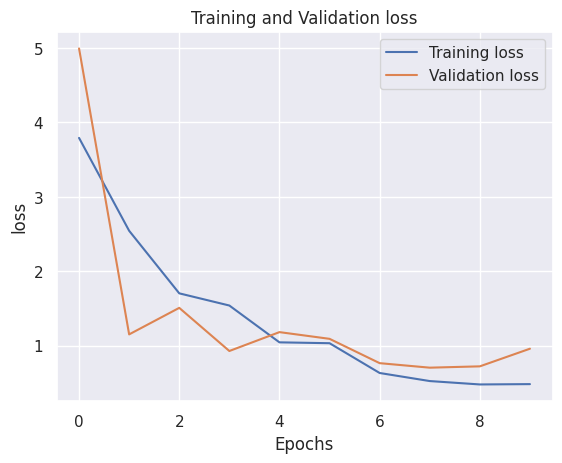

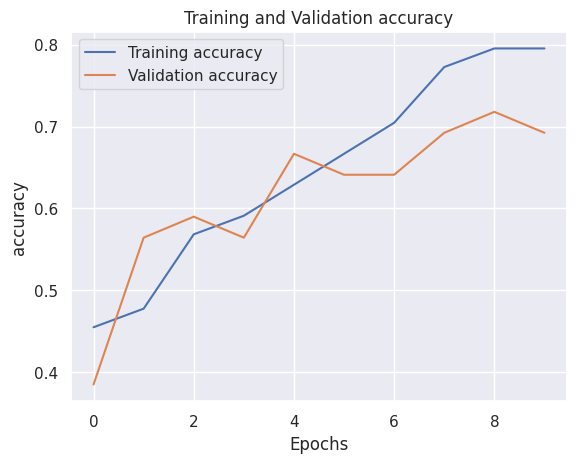

In [ ]:
def plot_metrics(history, metric):
    plt.plot(history_4.history[metric], label='Training ' + metric)
    plt.plot(history_4.history['val_' + metric], label='Validation ' + metric)
    plt.xlabel('Epochs')
    plt.ylabel(metric)
    plt.title('Training and Validation ' + metric)
    plt.legend()
    plt.show()
plot_metrics(history_4, 'loss')
plot_metrics(history_4, 'accuracy')

In [ ]:
train_loss4, train_accuracy4 = model_4.evaluate(train_generator)
validation_loss4, validation_accuracy4 = model_4.evaluate(validation_generator)
test_loss4, test_accuracy4 = model_4.evaluate(test_generator)

print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Train Loss:':<20} {train_loss4}")
print(f"{'Train Accuracy:':<20} {train_accuracy4}")
print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Validation Loss:':<20} {validation_loss4}")
print(f"{'Validation Accuracy:':<20} {validation_accuracy4}")
print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Test Loss:':<20} {test_loss4}")
print(f"{'Test Accuracy:':<20} {test_accuracy4}")

2/2 [==============================] - 5s 682ms/step - loss: 0.9040 - accuracy: 0.6154

----------------------------------------
----------------------------------------
Train Loss:          0.3919481039047241
Train Accuracy:      0.8409090638160706

----------------------------------------
----------------------------------------
Validation Loss:     0.9584237337112427
Validation Accuracy: 0.692307710647583

----------------------------------------
----------------------------------------
Test Loss:           0.9039837718009949
Test Accuracy:       0.6153846383094788


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.492937 to fit



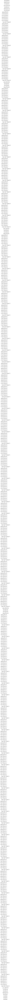

In [ ]:
from tensorflow.keras.utils import plot_model



# Visualize the model
plot_model(model_4, to_file='model_plot.png', show_shapes=True, show_layer_names=True)


Found 39 images belonging to 3 classes.
1/1 [==============================] - 0s 135ms/step


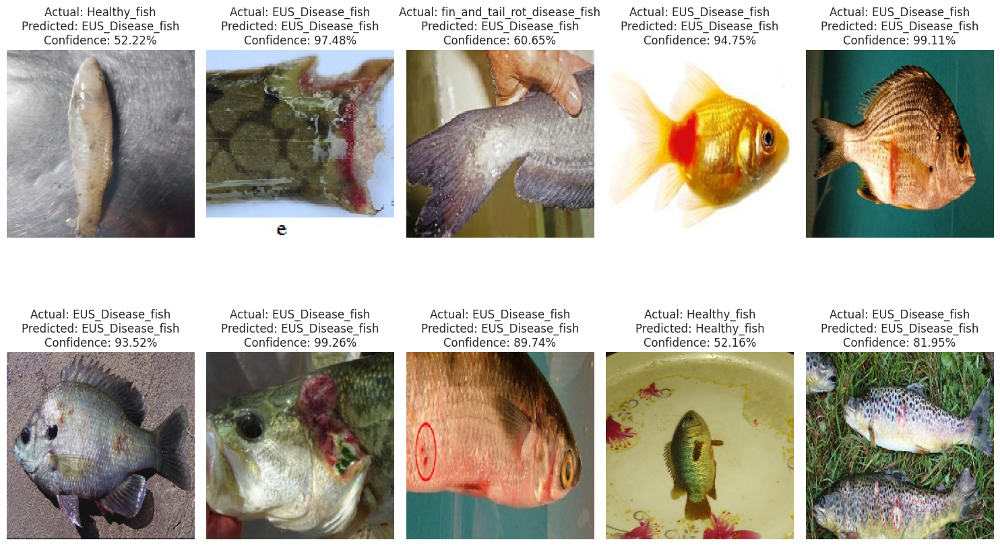

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create an instance of ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255)

# Create a generator for your dataset
generator = datagen.flow_from_directory('/content/drive/MyDrive/New folder fish/testing', target_size=(224, 224), batch_size=32, class_mode='categorical')

# Get the class labels from the generator
class_names = list(generator.class_indices.keys())

plt.figure(figsize=(15, 10))

# Define the number of rows and columns for the grid
num_rows = 2
num_cols = 5

# Define the number of images to display
num_images_to_display = num_rows * num_cols

# Initialize a counter for the images
image_counter = 0

# Iterate through the generator to collect and process the desired number of batches
for _ in range(num_images_to_display):
    batch = next(generator)  # Get the next batch of images and labels

    # Extract images and labels from the batch
    images_batch, labels_batch = batch

    # Iterate through the batch and display each image in the grid
    for i in range(len(images_batch)):
        if image_counter >= num_images_to_display:
            break

        image = images_batch[i]
        label = labels_batch[i]

        # Make predictions for the image using your model (you need to define and load your model)
        batch_prediction = model_4.predict(np.expand_dims(image, axis=0))

        # Calculate the confidence percentage for the predicted class
        confidence_percentage = np.max(batch_prediction) * 100

        # Create a subplot in the grid
        plt.subplot(num_rows, num_cols, image_counter + 1)

        # Display the image
        plt.imshow(image)
        plt.axis("off")  # Hide axis

        # Print the actual label, predicted label, and confidence percentage
        actual_label = class_names[np.argmax(label)]
        predicted_label = class_names[np.argmax(batch_prediction)]
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}\nConfidence: {confidence_percentage:.2f}%")

        image_counter += 1

# Adjust the spacing and display the grid
plt.tight_layout()
plt.show()


2/2 [==============================] - 7s 965ms/step


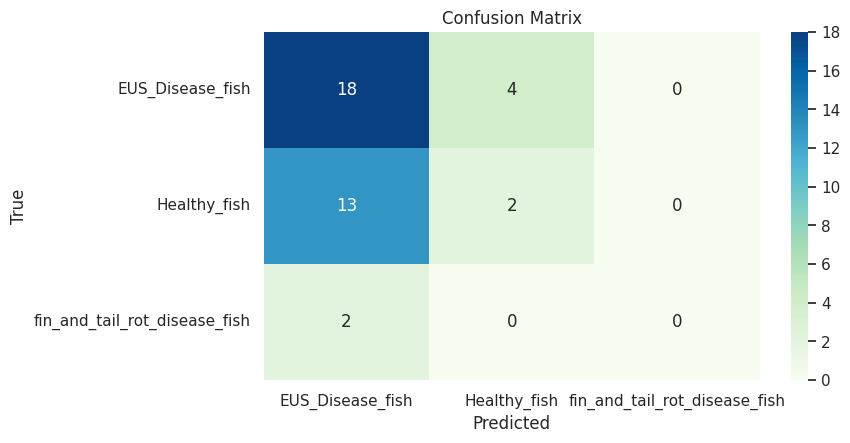

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Assuming you have a model 'model' and a train generator 'train_generator'
# Generate predictions from the model using the train generator
y_pred = model_4.predict(test_generator)

# Convert predicted probabilities to class labels (adjust as needed)
y_pred_labels = y_pred.argmax(axis=1)

# Get the true labels from the train generator
y_true = test_generator.classes

# Calculate the confusion matrix
cm = confusion_matrix(y_true, y_pred_labels)

# Define class names (replace with your class names)
class_names = list(test_generator.class_indices.keys())

# Create a heatmap for the confusion matrix with a different color map
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')

# Adjust the layout to provide more space for bottom labels
plt.subplots_adjust(bottom=0.30)

plt.show()


In [ ]:
from sklearn.metrics import classification_report

# Calculate classification metrics using the confusion matrix
report = classification_report(y_true, y_pred_labels, target_names=class_names)

# Print the classification report
print(report)


                               precision    recall  f1-score   support

             EUS_Disease_fish       0.55      0.82      0.65        22
                 Healthy_fish       0.33      0.13      0.19        15
fin_and_tail_rot_disease_fish       0.00      0.00      0.00         2

                     accuracy                           0.51        39
                    macro avg       0.29      0.32      0.28        39
                 weighted avg       0.44      0.51      0.44        39



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import classification_report

# Assuming you have true labels and predicted labels for your model
y_true = train_generator.classes  # Replace with your true labels
y_pred_labels = model_4.predict(train_generator).argmax(axis=1)  # Convert predicted probabilities to class labels

# Generate a classification report
report = classification_report(y_true, y_pred_labels, target_names=class_names, output_dict=True)

# Extract and print the average values
average_metrics = report['macro avg']
print(f"Metric          Value")
print(f"Accuracy:       {average_metrics['precision']:.4f}")
print(f"Precision:      {average_metrics['precision']:.4f}")
print(f"Recall:         {average_metrics['recall']:.4f}")
print(f"F1 Score:       {average_metrics['f1-score']:.4f}")
print(f"Support:        {average_metrics['support']:.2f}")


5/5 [==============================] - 18s 3s/step
Metric          Value
Accuracy:       0.3506
Precision:      0.3506
Recall:         0.3651
F1 Score:       0.3552
Support:        132.00


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
#vgg16
# Import necessary libraries
from keras.applications.vgg16 import VGG16
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from keras.models import Model

# VGG16 model with pre-trained weights
vgg16 = VGG16(input_shape=(224, 224, 3), weights='imagenet', include_top=False)

# Freeze all layers of the VGG16 model
for layer in vgg16.layers:
    layer.trainable = False

# Additional layers for classification
x = vgg16.output
x = Conv2D(filters=64, kernel_size=(3, 3), activation='relu')(x)
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.2)(x)

# Output layer for three-class classification
num_classes = 3  # Replace with the actual number of classes
prediction = Dense(num_classes, activation='softmax')(x)

# Create the model
model_5 = Model(inputs=vgg16.input, outputs=prediction)

# Compile the model with appropriate loss and optimizer
model_5.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Display model summary
model_5.summary()


58889256/58889256 [==============================] - 0s 0us/step
Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                            

In [ ]:
history_5=model_5.fit(train_generator,validation_data=validation_generator,epochs=10)

Epoch 1/10
5/5 [==============================] - 79s 16s/step - loss: 1.3845 - accuracy: 0.4848 - val_loss: 0.9033 - val_accuracy: 0.3846
Epoch 2/10
5/5 [==============================] - 70s 17s/step - loss: 0.9291 - accuracy: 0.5076 - val_loss: 0.8417 - val_accuracy: 0.5641
Epoch 3/10
5/5 [==============================] - 74s 15s/step - loss: 0.8938 - accuracy: 0.5455 - val_loss: 1.0025 - val_accuracy: 0.3846
Epoch 4/10
5/5 [==============================] - 69s 14s/step - loss: 0.8359 - accuracy: 0.5758 - val_loss: 0.8302 - val_accuracy: 0.5641
Epoch 5/10
5/5 [==============================] - 71s 14s/step - loss: 0.8028 - accuracy: 0.6061 - val_loss: 0.8058 - val_accuracy: 0.5641
Epoch 6/10
5/5 [==============================] - 68s 17s/step - loss: 0.7245 - accuracy: 0.6439 - val_loss: 0.8101 - val_accuracy: 0.6410
Epoch 7/10
5/5 [==============================] - 70s 14s/step - loss: 0.6466 - accuracy: 0.7424 - val_loss: 0.8112 - val_accuracy: 0.6923
Epoch 8/10
5/5 [===========

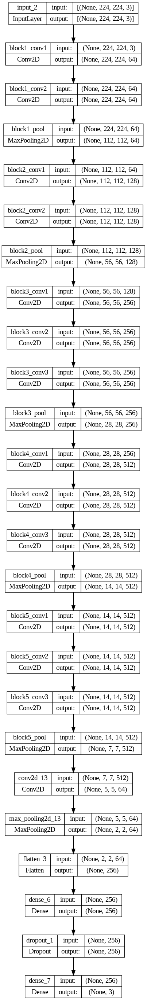

In [ ]:
from tensorflow.keras.utils import plot_model



# Visualize the model
plot_model(model_5, to_file='model_plot.png', show_shapes=True, show_layer_names=True)


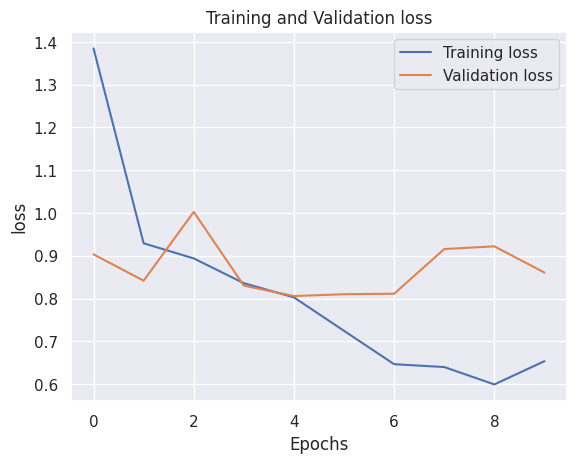

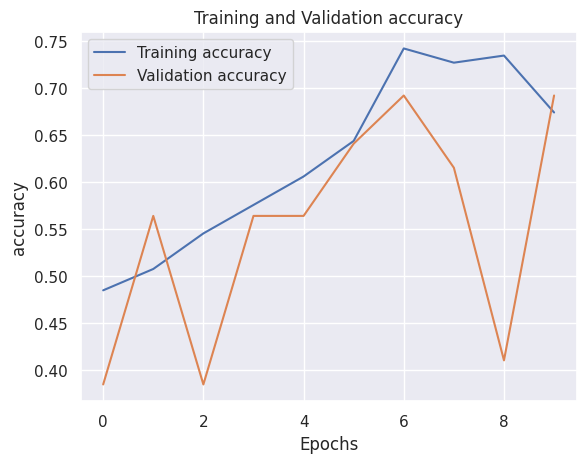

In [ ]:
def plot_metrics(history, metric):
    plt.plot(history_5.history[metric], label='Training ' + metric)
    plt.plot(history_5.history['val_' + metric], label='Validation ' + metric)
    plt.xlabel('Epochs')
    plt.ylabel(metric)
    plt.title('Training and Validation ' + metric)
    plt.legend()
    plt.show()
plot_metrics(history_5, 'loss')
plot_metrics(history_5, 'accuracy')

In [ ]:
train_loss5, train_accuracy5 = model_5.evaluate(train_generator)
validation_loss5, validation_accuracy5 = model_5.evaluate(validation_generator)
test_loss5, test_accuracy5 = model_5.evaluate(test_generator)

print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Train Loss:':<20} {train_loss5}")
print(f"{'Train Accuracy:':<20} {train_accuracy5}")
print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Validation Loss:':<20} {validation_loss5}")
print(f"{'Validation Accuracy:':<20} {validation_accuracy5}")
print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Test Loss:':<20} {test_loss5}")
print(f"{'Test Accuracy:':<20} {test_accuracy5}")

2/2 [==============================] - 16s 3s/step - loss: 1.0073 - accuracy: 0.5385

----------------------------------------
----------------------------------------
Train Loss:          0.5392141342163086
Train Accuracy:      0.7727272510528564

----------------------------------------
----------------------------------------
Validation Loss:     0.8607202172279358
Validation Accuracy: 0.692307710647583

----------------------------------------
----------------------------------------
Test Loss:           1.0073038339614868
Test Accuracy:       0.5384615659713745


Found 39 images belonging to 3 classes.
1/1 [==============================] - 1s 508ms/step


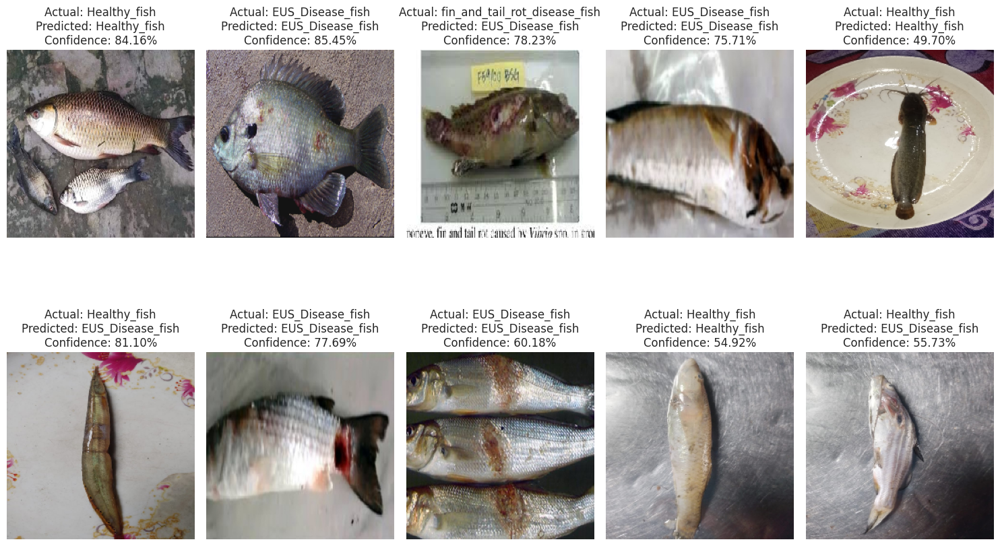

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create an instance of ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255)

# Create a generator for your dataset
generator = datagen.flow_from_directory('/content/drive/MyDrive/New folder fish/testing', target_size=(224, 224), batch_size=32, class_mode='categorical')

# Get the class labels from the generator
class_names = list(generator.class_indices.keys())

plt.figure(figsize=(15, 10))

# Define the number of rows and columns for the grid
num_rows = 2
num_cols = 5

# Define the number of images to display
num_images_to_display = num_rows * num_cols

# Initialize a counter for the images
image_counter = 0

# Iterate through the generator to collect and process the desired number of batches
for _ in range(num_images_to_display):
    batch = next(generator)  # Get the next batch of images and labels

    # Extract images and labels from the batch
    images_batch, labels_batch = batch

    # Iterate through the batch and display each image in the grid
    for i in range(len(images_batch)):
        if image_counter >= num_images_to_display:
            break

        image = images_batch[i]
        label = labels_batch[i]

        # Make predictions for the image using your model (you need to define and load your model)
        batch_prediction = model_5.predict(np.expand_dims(image, axis=0))

        # Calculate the confidence percentage for the predicted class
        confidence_percentage = np.max(batch_prediction) * 100

        # Create a subplot in the grid
        plt.subplot(num_rows, num_cols, image_counter + 1)

        # Display the image
        plt.imshow(image)
        plt.axis("off")  # Hide axis

        # Print the actual label, predicted label, and confidence percentage
        actual_label = class_names[np.argmax(label)]
        predicted_label = class_names[np.argmax(batch_prediction)]
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}\nConfidence: {confidence_percentage:.2f}%")

        image_counter += 1

# Adjust the spacing and display the grid
plt.tight_layout()
plt.show()


2/2 [==============================] - 16s 3s/step


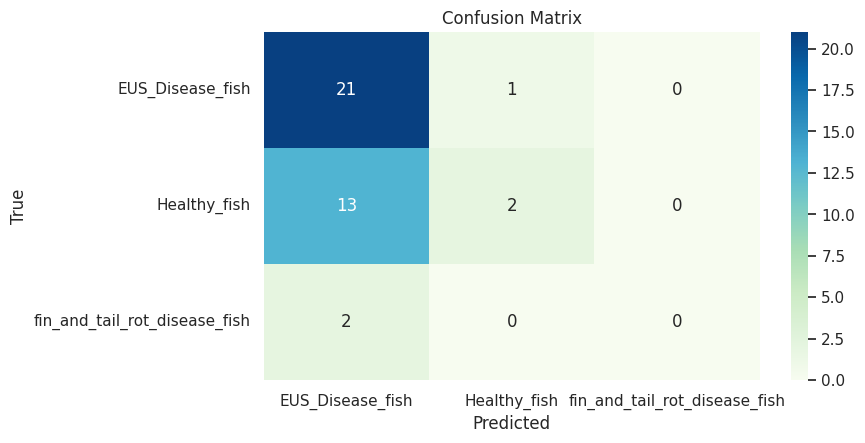

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Assuming you have a model 'model' and a train generator 'train_generator'
# Generate predictions from the model using the train generator
y_pred1 = model_5.predict(test_generator)

# Convert predicted probabilities to class labels (adjust as needed)
y_pred_labels1 = y_pred1.argmax(axis=1)

# Get the true labels from the train generator
y_true1 = test_generator.classes

# Calculate the confusion matrix
cm = confusion_matrix(y_true1, y_pred_labels1)

# Define class names (replace with your class names)
class_names = list(test_generator.class_indices.keys())

# Create a heatmap for the confusion matrix with a different color map
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')

# Adjust the layout to provide more space for bottom labels
plt.subplots_adjust(bottom=0.30)

plt.show()


In [ ]:
from sklearn.metrics import classification_report

# Calculate classification metrics using the confusion matrix
report = classification_report(y_true1, y_pred_labels1, target_names=class_names)

# Print the classification report
print(report)

                               precision    recall  f1-score   support

             EUS_Disease_fish       0.58      0.95      0.72        22
                 Healthy_fish       0.67      0.13      0.22        15
fin_and_tail_rot_disease_fish       0.00      0.00      0.00         2

                     accuracy                           0.59        39
                    macro avg       0.42      0.36      0.32        39
                 weighted avg       0.59      0.59      0.49        39



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import classification_report

# Assuming you have true labels and predicted labels for your model
y_true1 = train_generator.classes  # Replace with your true labels
y_pred_labels1 = model_5.predict(train_generator).argmax(axis=1)  # Convert predicted probabilities to class labels

# Generate a classification report
report = classification_report(y_true1, y_pred_labels1, target_names=class_names, output_dict=True)

# Extract and print the average values
average_metrics = report['macro avg']
print(f"Metric          Value")
print(f"Accuracy:       {average_metrics['precision']:.4f}")
print(f"Precision:      {average_metrics['precision']:.4f}")
print(f"Recall:         {average_metrics['recall']:.4f}")
print(f"F1 Score:       {average_metrics['f1-score']:.4f}")
print(f"Support:        {average_metrics['support']:.2f}")


5/5 [==============================] - 55s 10s/step
Metric          Value
Accuracy:       0.3345
Precision:      0.3345
Recall:         0.3492
F1 Score:       0.3372
Support:        132.00


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
#Xception

# Import necessary libraries
from keras.applications.xception import Xception
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from keras.models import Model

# Xception model with pre-trained weights
xception = Xception(input_shape=(224, 224, 3), weights='imagenet', include_top=False)

# Freeze all layers of the Xception model
for layer in xception.layers:
    layer.trainable = False

# Additional layers for classification
x = xception.output
x = Conv2D(filters=64, kernel_size=(3, 3), activation='relu')(x)
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.2)(x)

# Output layer for three-class classification
num_classes = 3  # Replace with the actual number of classes
prediction = Dense(num_classes, activation='softmax')(x)

# Create the model
model_6 = Model(inputs=xception.input, outputs=prediction)

# Compile the model with appropriate loss and optimizer
model_6.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Display model summary
model_6.summary()


83683744/83683744 [==============================] - 0s 0us/step
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 111, 111, 32)         864       ['input_3[0][0]']             
                                                                                                  
 block1_conv1_bn (BatchNorm  (None, 111, 111, 32)         128       ['block1_conv1[0][0]']        
 alization)                                                                                       
                                                                                                  
 block1_conv1_act (Activati

In [ ]:
history_6=model_6.fit(train_generator,validation_data=validation_generator,epochs=10)

Epoch 1/10
5/5 [==============================] - 32s 6s/step - loss: 3.2385 - accuracy: 0.4545 - val_loss: 2.5497 - val_accuracy: 0.4103
Epoch 2/10
5/5 [==============================] - 31s 6s/step - loss: 2.4490 - accuracy: 0.5530 - val_loss: 2.7837 - val_accuracy: 0.3846
Epoch 3/10
5/5 [==============================] - 31s 6s/step - loss: 2.2239 - accuracy: 0.4773 - val_loss: 1.8765 - val_accuracy: 0.5641
Epoch 4/10
5/5 [==============================] - 31s 6s/step - loss: 1.0576 - accuracy: 0.5758 - val_loss: 1.1347 - val_accuracy: 0.4103
Epoch 5/10
5/5 [==============================] - 31s 6s/step - loss: 0.7675 - accuracy: 0.6667 - val_loss: 0.9576 - val_accuracy: 0.6154
Epoch 6/10
5/5 [==============================] - 30s 6s/step - loss: 0.6188 - accuracy: 0.7424 - val_loss: 0.8816 - val_accuracy: 0.6154
Epoch 7/10
5/5 [==============================] - 30s 7s/step - loss: 0.5063 - accuracy: 0.7879 - val_loss: 1.1267 - val_accuracy: 0.6410
Epoch 8/10
5/5 [==================

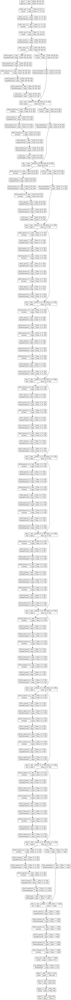

In [ ]:
from tensorflow.keras.utils import plot_model



# Visualize the model
plot_model(model_6, to_file='model_plot.png', show_shapes=True, show_layer_names=True)


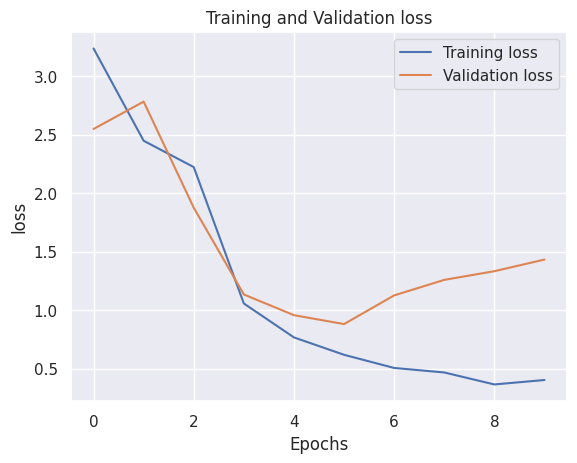

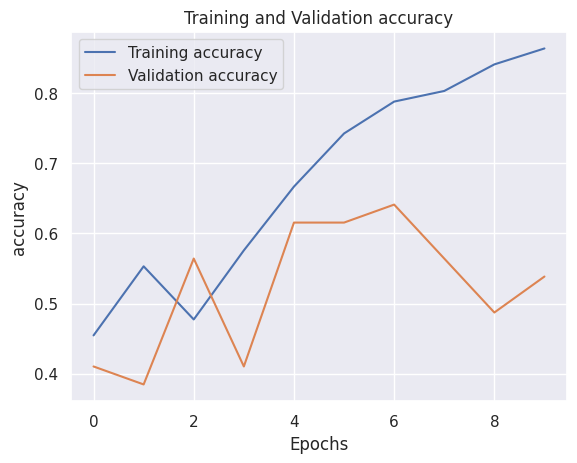

In [ ]:
def plot_metrics(history, metric):
    plt.plot(history_6.history[metric], label='Training ' + metric)
    plt.plot(history_6.history['val_' + metric], label='Validation ' + metric)
    plt.xlabel('Epochs')
    plt.ylabel(metric)
    plt.title('Training and Validation ' + metric)
    plt.legend()
    plt.show()
plot_metrics(history_6, 'loss')
plot_metrics(history_6, 'accuracy')

In [ ]:
train_loss6, train_accuracy6 = model_6.evaluate(train_generator)
validation_loss6, validation_accuracy6 = model_6.evaluate(validation_generator)
test_loss6, test_accuracy6 = model_6.evaluate(test_generator)

print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Train Loss:':<20} {train_loss6}")
print(f"{'Train Accuracy:':<20} {train_accuracy6}")
print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Validation Loss:':<20} {validation_loss6}")
print(f"{'Validation Accuracy:':<20} {validation_accuracy6}")
print('\n' + '-'*40 + '\n' + '-'*40)
print(f"{'Test Loss:':<20} {test_loss6}")
print(f"{'Test Accuracy:':<20} {test_accuracy6}")

2/2 [==============================] - 6s 1s/step - loss: 1.5143 - accuracy: 0.5897

----------------------------------------
----------------------------------------
Train Loss:          0.346056193113327
Train Accuracy:      0.8636363744735718

----------------------------------------
----------------------------------------
Validation Loss:     1.4331368207931519
Validation Accuracy: 0.5384615659713745

----------------------------------------
----------------------------------------
Test Loss:           1.5142922401428223
Test Accuracy:       0.5897436141967773


2/2 [==============================] - 16s 3s/step


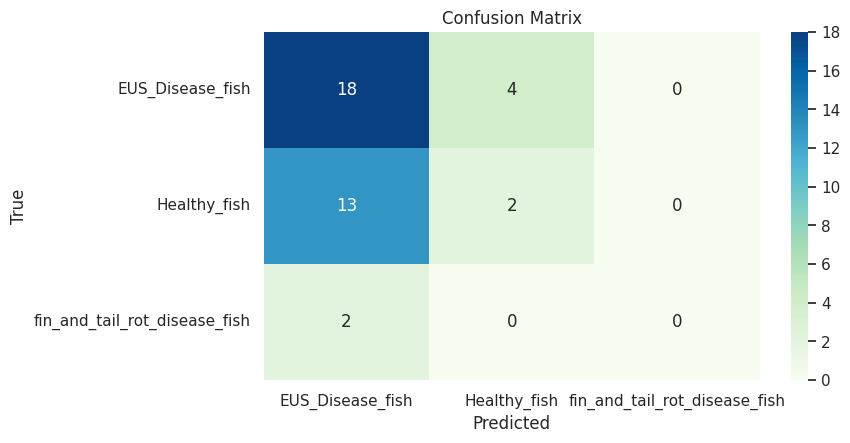

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Assuming you have a model 'model' and a train generator 'train_generator'
# Generate predictions from the model using the train generator
y_pred2 = model_5.predict(test_generator)

# Convert predicted probabilities to class labels (adjust as needed)
y_pred_labels2 = y_pred.argmax(axis=1)

# Get the true labels from the train generator
y_true2 = test_generator.classes

# Calculate the confusion matrix
cm = confusion_matrix(y_true2, y_pred_labels2)

# Define class names (replace with your class names)
class_names = list(test_generator.class_indices.keys())

# Create a heatmap for the confusion matrix with a different color map
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='GnBu', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')

# Adjust the layout to provide more space for bottom labels
plt.subplots_adjust(bottom=0.30)

plt.show()


In [ ]:
from sklearn.metrics import classification_report

# Calculate classification metrics using the confusion matrix
report = classification_report(y_true2, y_pred_labels2, target_names=class_names)

# Print the classification report
print(report)


                               precision    recall  f1-score   support

             EUS_Disease_fish       0.55      0.82      0.65        22
                 Healthy_fish       0.33      0.13      0.19        15
fin_and_tail_rot_disease_fish       0.00      0.00      0.00         2

                     accuracy                           0.51        39
                    macro avg       0.29      0.32      0.28        39
                 weighted avg       0.44      0.51      0.44        39



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import classification_report

# Assuming you have true labels and predicted labels for your model
y_true2 = train_generator.classes  # Replace with your true labels
y_pred_labels2 = model_5.predict(train_generator).argmax(axis=1)  # Convert predicted probabilities to class labels

# Generate a classification report
report = classification_report(y_true2, y_pred_labels2, target_names=class_names, output_dict=True)

# Extract and print the average values
average_metrics = report['macro avg']
print(f"Metric          Value")
print(f"Accuracy:       {average_metrics['precision']:.4f}")
print(f"Precision:      {average_metrics['precision']:.4f}")
print(f"Recall:         {average_metrics['recall']:.4f}")
print(f"F1 Score:       {average_metrics['f1-score']:.4f}")
print(f"Support:        {average_metrics['support']:.2f}")


5/5 [==============================] - 53s 10s/step
Metric          Value
Accuracy:       0.2961
Precision:      0.2961
Recall:         0.3122
F1 Score:       0.2968
Support:        132.00


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Found 39 images belonging to 3 classes.
1/1 [==============================] - 0s 143ms/step


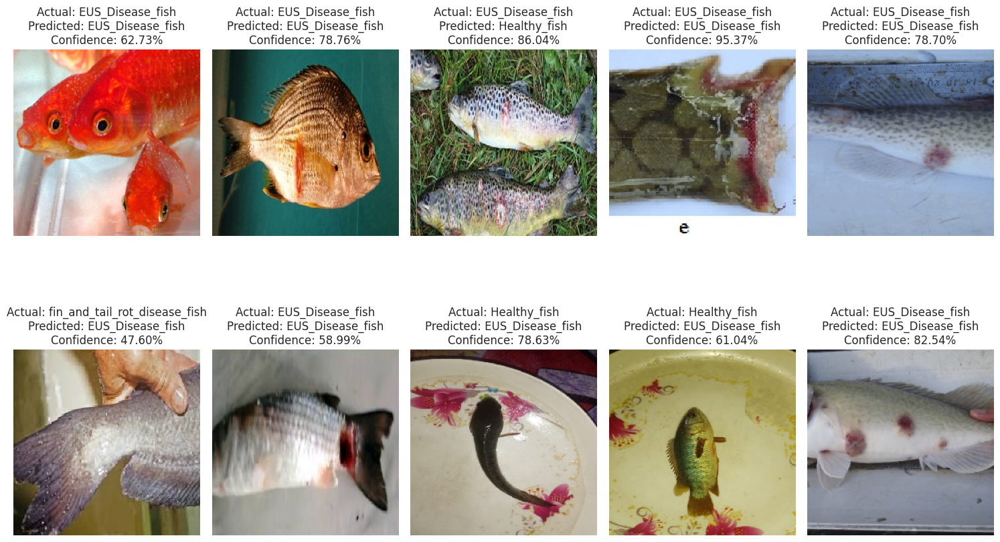

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create an instance of ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255)

# Create a generator for your dataset
generator = datagen.flow_from_directory('/content/drive/MyDrive/New folder fish/testing', target_size=(224, 224), batch_size=32, class_mode='categorical')

# Get the class labels from the generator
class_names = list(generator.class_indices.keys())

plt.figure(figsize=(15, 10))

# Define the number of rows and columns for the grid
num_rows = 2
num_cols = 5

# Define the number of images to display
num_images_to_display = num_rows * num_cols

# Initialize a counter for the images
image_counter = 0

# Iterate through the generator to collect and process the desired number of batches
for _ in range(num_images_to_display):
    batch = next(generator)  # Get the next batch of images and labels

    # Extract images and labels from the batch
    images_batch, labels_batch = batch

    # Iterate through the batch and display each image in the grid
    for i in range(len(images_batch)):
        if image_counter >= num_images_to_display:
            break

        image = images_batch[i]
        label = labels_batch[i]

        # Make predictions for the image using your model (you need to define and load your model)
        batch_prediction = model_6.predict(np.expand_dims(image, axis=0))

        # Calculate the confidence percentage for the predicted class
        confidence_percentage = np.max(batch_prediction) * 100

        # Create a subplot in the grid
        plt.subplot(num_rows, num_cols, image_counter + 1)

        # Display the image
        plt.imshow(image)
        plt.axis("off")  # Hide axis

        # Print the actual label, predicted label, and confidence percentage
        actual_label = class_names[np.argmax(label)]
        predicted_label = class_names[np.argmax(batch_prediction)]
        plt.title(f"Actual: {actual_label}\nPredicted: {predicted_label}\nConfidence: {confidence_percentage:.2f}%")

        image_counter += 1

# Adjust the spacing and display the grid
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
from tensorflow.keras.models import load_model
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Function to generate predictions in batches
def generate_predictions(model, generator):
    predictions = []
    labels = []

    # Reset the generator to the beginning
    generator.reset()

    # Iterate over batches
    for _ in range(generator.n // generator.batch_size + 1):
        images, batch_labels = next(generator)

        # Predict on the current batch
        batch_preds = model.predict(images)

        predictions.append(batch_preds)
        labels.append(batch_labels)

    # Concatenate the results
    predictions = np.concatenate(predictions, axis=0)
    labels = np.concatenate(labels, axis=0)

    return predictions, labels

# Generate predictions from each model in batches
densenet_preds, _ = generate_predictions(model_4, test_generator)
vgg16_preds, _ = generate_predictions(model_5, test_generator)
xception_preds, _ = generate_predictions(model_6, test_generator)

# Define weights based on model performance (you can adjust these)
weights = [0.2, 0.1, 0.2]

# Weighted averaging of predictions
ensemble_preds = np.average([densenet_preds, vgg16_preds, xception_preds], axis=0, weights=weights)
ensemble_labels = np.argmax(ensemble_preds, axis=1)

# Get true labels from the test dataset
test_labels = test_generator.classes[:len(ensemble_labels)]

# Evaluate the ensemble model
ensemble_accuracy = accuracy_score(test_labels, ensemble_labels)
ensemble_precision = precision_score(test_labels, ensemble_labels, average='macro')
ensemble_recall = recall_score(test_labels, ensemble_labels, average='macro')
ensemble_f1 = f1_score(test_labels, ensemble_labels, average='macro')

# Print the results
print(f"Ensemble Accuracy: {ensemble_accuracy:.4f}")
print(f"Ensemble Precision: {ensemble_precision:.4f}")
print(f"Ensemble Recall: {ensemble_recall:.4f}")
print(f"Ensemble F1 Score: {ensemble_f1:.4f}")


1/1 [==============================] - 1s 860ms/step
Ensemble Accuracy: 0.6154
Ensemble Precision: 0.4259
Ensemble Recall: 0.3778
Ensemble F1 Score: 0.3269


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1.Canny Edge Detection

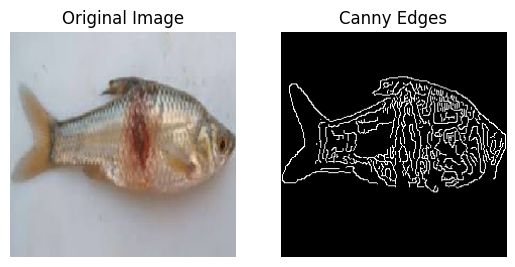

In [ ]:
import numpy as np
from tensorflow import keras
from tensorflow.keras.layers import Input, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
from skimage.feature import canny


img_path = '/content/14.jpg'
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = img_array / 255.0  # Normalize


gray_img = np.mean(img_array, axis=2)

# Apply Canny Edge Detection
edges = canny(gray_img)
num_classes = 10

# A simple Keras model for classification
input_layer = Input(shape=(224, 224, 1))
x = Flatten()(input_layer)
x = Dense(128, activation='relu')(x)
output_layer = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=input_layer, outputs=output_layer)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(img)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Canny Edges')
plt.imshow(edges, cmap='gray')
plt.axis('off')

plt.show()


2.Prewitt Edge Detection

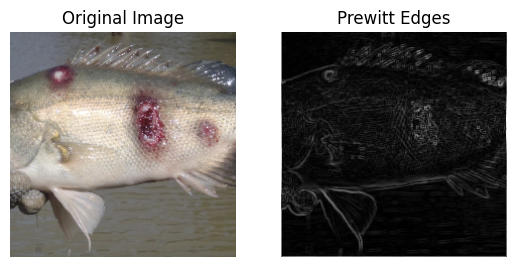

In [ ]:

import numpy as np
from tensorflow import keras
from tensorflow.keras.layers import Input, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
from scipy.signal import convolve2d


img_path = '/content/IMG_20230927_221821.jpg'
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = img_array / 255.0
gray_img = np.mean(img_array, axis=2)

# Define Prewitt kernels
kernel_x = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]])
kernel_y = np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]])
# Apply Prewitt Edge Detection
edges_x = np.abs(convolve2d(gray_img, kernel_x, mode='same'))
edges_y = np.abs(convolve2d(gray_img, kernel_y, mode='same'))

edges = np.sqrt(edges_x**2 + edges_y**2)

num_classes = 10

# A simple Keras model for classification
input_layer = Input(shape=(224, 224, 1))
x = Flatten()(input_layer)
x = Dense(128, activation='relu')(x)
output_layer = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=input_layer, outputs=output_layer)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(img)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Prewitt Edges')
plt.imshow(edges, cmap='gray')
plt.axis('off')

plt.show()



3.Robert Edge Detection

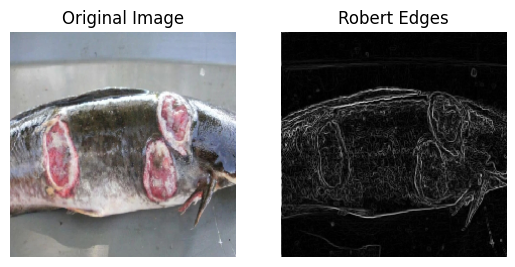

In [ ]:
import numpy as np
from tensorflow import keras
from tensorflow.keras.layers import Input, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
from scipy.signal import convolve2d


img_path = '/content/IMG_20230927_213532.jpg'
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = img_array / 255.0


gray_img = np.mean(img_array, axis=2)

# Define Robert kernels
kernel_x = np.array([[-1, 0], [0, 1]])
kernel_y = np.array([[0, -1], [1, 0]])

# Apply Robert Edge Detection
edges_x = np.abs(convolve2d(gray_img, kernel_x, mode='same', boundary='wrap'))
edges_y = np.abs(convolve2d(gray_img, kernel_y, mode='same', boundary='wrap'))

edges = np.sqrt(edges_x**2 + edges_y**2)

num_classes = 10

# A simple Keras model for classification
input_layer = Input(shape=(224, 224, 1))
x = Flatten()(input_layer)
x = Dense(128, activation='relu')(x)
output_layer = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=input_layer, outputs=output_layer)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(img)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Robert Edges')
plt.imshow(edges, cmap='gray')
plt.axis('off')

plt.show()


4.Sobel Edge Detection

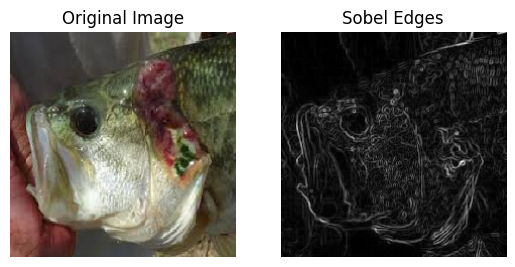

In [ ]:
import numpy as np
from tensorflow import keras
from tensorflow.keras.layers import Input, Conv2D, Activation, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
from scipy.ndimage import sobel

img_path = '/content/12.jpg'
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = img_array / 255.0


gray_img = np.mean(img_array, axis=2)

# Apply Sobel Edge Detection
sobel_x = sobel(gray_img, axis=0, mode='reflect')
sobel_y = sobel(gray_img, axis=1, mode='reflect')
sobel = np.sqrt(sobel_x**2 + sobel_y**2)

# A Keras model that includes Sobel edge detection
input_layer = Input(shape=(224, 224, 1))
conv1 = Conv2D(32, (3, 3))(input_layer)
activation1 = Activation('relu')(conv1)
flatten = Flatten()(activation1)
dense1 = Dense(128, activation='relu')(flatten)
output_layer = Dense(num_classes, activation='softmax')(dense1)

model = Model(inputs=input_layer, outputs=output_layer)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Predict Sobel edges and use them as input to the model
sobel = sobel.astype('float32')
sobel = sobel / 255.0
sobel = sobel.reshape((1, 224, 224, 1))  # Reshape


plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(img)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Sobel Edges')
plt.imshow(sobel[0, :, :, 0], cmap='gray')
plt.axis('off')


plt.show()


5.Marr-Hildreth Edge Detection

1/1 [==============================] - 0s 62ms/step


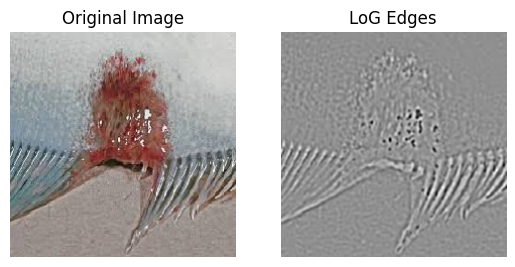

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Flatten, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter, gaussian_laplace
import numpy as np


def applyLoGFilter(image):
    blurred = gaussian_filter(image, sigma=1.0)
    log_edges = gaussian_laplace(blurred, sigma=1.0)
    return log_edges


img_path = '/content/download (1).jpg'
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = img_array / 255.0


gray_img = np.mean(img_array, axis=2)

# Apply LoG filter to the image
log_edges = applyLoGFilter(gray_img)


input_layer = Input(shape=(224, 224, 1))
x = Flatten()(input_layer)
x = Dense(128, activation='relu')(x)
output_layer = Dense(1, activation='linear')(x)

model = Model(inputs=input_layer, outputs=output_layer)


log_edges = log_edges.reshape(1, 224, 224, 1)

predictions = model.predict(log_edges)


plt.subplot(1, 2, 1)
plt.title('Original Image')
plt.imshow(img)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('LoG Edges')
plt.imshow(log_edges[0, ..., 0], cmap='gray')
plt.axis('off')

plt.show()
